<a href="https://colab.research.google.com/github/Jabullae/Deep_Learning/blob/main/actual_taco_litter_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    pass
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Download yoloV5

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install kaggle

from google.colab import files
files.upload()

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"jabullae","key":"9615fe6e84855ac0d22aa288ab5d10bd"}'}

In [3]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [4]:
! kaggle datasets download -d kneroma/tacotrashdataset

100% 2.77G/2.79G [00:24<00:00, 165MB/s]
100% 2.79G/2.79G [00:24<00:00, 124MB/s]


In [5]:
! unzip tacotrashdataset.zip

Archive:  tacotrashdataset.zip
  inflating: best-checkpoint-003epoch.bin  
  inflating: data/annotations.json   
  inflating: data/batch_1/000000.jpg  
  inflating: data/batch_1/000001.jpg  
  inflating: data/batch_1/000003.jpg  
  inflating: data/batch_1/000004.jpg  
  inflating: data/batch_1/000005.jpg  
  inflating: data/batch_1/000006.jpg  
  inflating: data/batch_1/000007.jpg  
  inflating: data/batch_1/000008.jpg  
  inflating: data/batch_1/000010.jpg  
  inflating: data/batch_1/000011.jpg  
  inflating: data/batch_1/000012.jpg  
  inflating: data/batch_1/000013.jpg  
  inflating: data/batch_1/000014.jpg  
  inflating: data/batch_1/000015.jpg  
  inflating: data/batch_1/000016.jpg  
  inflating: data/batch_1/000017.jpg  
  inflating: data/batch_1/000019.jpg  
  inflating: data/batch_1/000021.jpg  
  inflating: data/batch_1/000022.jpg  
  inflating: data/batch_1/000023.jpg  
  inflating: data/batch_1/000024.jpg  
  inflating: data/batch_1/000025.jpg  
  inflating: data/batch_1/000

In [6]:
!ls 

best-checkpoint-003epoch.bin  drive	   kle_log.txt	sample_data
data			      kaggle.json  meta_df.csv	tacotrashdataset.zip


In [7]:
!git clone https://github.com/ultralytics/yolov5  # clone
%cd yolov5
%pip install -qr requirements.txt  # install

# %pip install torch==1.9.0 torchvision==0.10.0 torchaudio==0.9.0

import torch
from yolov5 import utils
display = utils.notebook_init()  # checks
print (torch.__version__)

YOLOv5 🚀 v7.0-43-gf72f0fe Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (2 CPUs, 12.7 GB RAM, 28.6/78.2 GB disk)
1.13.0+cu116


In [8]:
!ls

benchmarks.py	 data	     LICENSE	      requirements.txt	tutorial.ipynb
CITATION.cff	 detect.py   models	      segment		utils
classify	 export.py   README.md	      setup.cfg		val.py
CONTRIBUTING.md  hubconf.py  README.zh-CN.md  train.py


In [9]:
# !pip uninstall typing -y
!pip install pycocotools

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [10]:
!pip install torch torchvision torchaudio 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [11]:
import os
import shutil
import numpy as np
import tqdm

In [12]:
!ls

benchmarks.py	 data	     LICENSE	      requirements.txt	tutorial.ipynb
CITATION.cff	 detect.py   models	      segment		utils
classify	 export.py   README.md	      setup.cfg		val.py
CONTRIBUTING.md  hubconf.py  README.zh-CN.md  train.py


**Read the annotations file**

In [14]:
from pycocotools.coco import COCO
data_source = COCO(annotation_file='/content/data/annotations.json')

loading annotations into memory...
Done (t=0.14s)
creating index...
index created!


In [15]:
catIds = data_source.getCatIds()
cats = data_source.loadCats(catIds)


In [16]:
cats

[{'supercategory': 'Aluminium foil', 'id': 0, 'name': 'Aluminium foil'},
 {'supercategory': 'Battery', 'id': 1, 'name': 'Battery'},
 {'supercategory': 'Blister pack', 'id': 2, 'name': 'Aluminium blister pack'},
 {'supercategory': 'Blister pack', 'id': 3, 'name': 'Carded blister pack'},
 {'supercategory': 'Bottle', 'id': 4, 'name': 'Other plastic bottle'},
 {'supercategory': 'Bottle', 'id': 5, 'name': 'Clear plastic bottle'},
 {'supercategory': 'Bottle', 'id': 6, 'name': 'Glass bottle'},
 {'supercategory': 'Bottle cap', 'id': 7, 'name': 'Plastic bottle cap'},
 {'supercategory': 'Bottle cap', 'id': 8, 'name': 'Metal bottle cap'},
 {'supercategory': 'Broken glass', 'id': 9, 'name': 'Broken glass'},
 {'supercategory': 'Can', 'id': 10, 'name': 'Food Can'},
 {'supercategory': 'Can', 'id': 11, 'name': 'Aerosol'},
 {'supercategory': 'Can', 'id': 12, 'name': 'Drink can'},
 {'supercategory': 'Carton', 'id': 13, 'name': 'Toilet tube'},
 {'supercategory': 'Carton', 'id': 14, 'name': 'Other carton'

**Creating a class Dictionary**
* `classes` = Mapping of Class Name to ID

In [17]:
classes = {}
taco_labels = {}
taco_labels_inverse = {}

for c in cats:
    taco_labels[len(classes)] = c['id']
    taco_labels_inverse[c['id']] = len(classes)
    classes[c['name']] = len(classes)

In [18]:
classes

{'Aluminium foil': 0,
 'Battery': 1,
 'Aluminium blister pack': 2,
 'Carded blister pack': 3,
 'Other plastic bottle': 4,
 'Clear plastic bottle': 5,
 'Glass bottle': 6,
 'Plastic bottle cap': 7,
 'Metal bottle cap': 8,
 'Broken glass': 9,
 'Food Can': 10,
 'Aerosol': 11,
 'Drink can': 12,
 'Toilet tube': 13,
 'Other carton': 14,
 'Egg carton': 15,
 'Drink carton': 16,
 'Corrugated carton': 17,
 'Meal carton': 18,
 'Pizza box': 19,
 'Paper cup': 20,
 'Disposable plastic cup': 21,
 'Foam cup': 22,
 'Glass cup': 23,
 'Other plastic cup': 24,
 'Food waste': 25,
 'Glass jar': 26,
 'Plastic lid': 27,
 'Metal lid': 28,
 'Other plastic': 29,
 'Magazine paper': 30,
 'Tissues': 31,
 'Wrapping paper': 32,
 'Normal paper': 33,
 'Paper bag': 34,
 'Plastified paper bag': 35,
 'Plastic film': 36,
 'Six pack rings': 37,
 'Garbage bag': 38,
 'Other plastic wrapper': 39,
 'Single-use carrier bag': 40,
 'Polypropylene bag': 41,
 'Crisp packet': 42,
 'Spread tub': 43,
 'Tupperware': 44,
 'Disposable food

**Splitting data into train, val and test**

In [19]:
!ls

benchmarks.py	 data	     LICENSE	      requirements.txt	tutorial.ipynb
CITATION.cff	 detect.py   models	      segment		utils
classify	 export.py   README.md	      setup.cfg		val.py
CONTRIBUTING.md  hubconf.py  README.zh-CN.md  train.py


In [20]:
!mkdir -p tmp/labels tmp/images
IMAGES_PATH = 'tmp/images/'
LABELS_PATH = 'tmp/labels/'

In [21]:
!ls tmp

images	labels


In [22]:
import shutil
import os

In [24]:
imgIds = data_source.getImgIds()
# print(data_source.loadImgs(0)[0])
for index, img_id in tqdm.tqdm(enumerate(imgIds)):
    img_info = data_source.loadImgs(img_id)[0]
      # img_dir: batch_x/.....jpg ---> batch_x_......jpg
    img_dir = img_info['file_name'].replace('/', '-')
    
    image_name = img_dir.split('.')[0]
    label_dir = LABELS_PATH + image_name + '.txt'
    
    height = img_info['height']
    width = img_info['width']
    
#     print ("Copying from /kaggle/input/tacotrashdataset/data/{} to {}".format(img_info['file_name'], os.path.join(IMAGES_PATH, img_dir)))
    # get images
    shutil.copy(f"/content/data/{img_info['file_name']}", os.path.join(IMAGES_PATH, img_dir))
        

    
      # get labels
    with open(label_dir, mode='w') as fp:
#         print (f"Creating label_dir {label_dir} for {image_name}")
        annotation_id = data_source.getAnnIds(img_id)
        if len(annotation_id) == 0:
            fp.write('')
            continue
        boxes = np.zeros((0, 5))
        annotations = data_source.loadAnns(annotation_id)
        lines = ''
        for annotation in annotations:
            label = taco_labels_inverse[annotation['category_id']]
            box = annotation['bbox']
            # some annotations have basically no width / height (extremely small), skip them
            if box[2] < 1 or box[3] < 1:
                continue
            # top_x,top_y,width,height ----> cen_x,cen_y,width,height
            # standardize to 0-1
            box[0] = round((box[0] + box[2] / 2) / width, 6)
            box[1] = round((box[1] + box[3] / 2) / height, 6)
            box[2] = round(box[2] / width, 6)
            box[3] = round(box[3] / height, 6)
            # line: label x_center y_center width height
            lines = lines + str(label)
            for i in box:
                lines += ' ' + str(i)
            lines += '\n'
        fp.writelines(lines)

1500it [00:09, 153.08it/s]


In [25]:
!ls

benchmarks.py	 data	     LICENSE	      requirements.txt	train.py
CITATION.cff	 detect.py   models	      segment		tutorial.ipynb
classify	 export.py   README.md	      setup.cfg		utils
CONTRIBUTING.md  hubconf.py  README.zh-CN.md  tmp		val.py


In [26]:
# test
annotation_id = data_source.getAnnIds(1)
data_source.loadAnns(annotation_id)

[{'id': 2,
  'image_id': 1,
  'category_id': 18,
  'segmentation': [[928.0,
    1876.0,
    938.0,
    1856.0,
    968.0,
    1826.0,
    990.0,
    1808.0,
    998.0,
    1790.0,
    1069.0,
    1727.0,
    1096.0,
    1702.0,
    1159.0,
    1644.0,
    1212.0,
    1588.0,
    1258.0,
    1540.0,
    1314.0,
    1482.0,
    1357.0,
    1444.0,
    1392.0,
    1416.0,
    1409.0,
    1393.0,
    1430.0,
    1369.0,
    1415.0,
    1347.0,
    1130.0,
    1087.0,
    780.0,
    763.0,
    528.0,
    533.0,
    479.0,
    486.0,
    466.0,
    466.0,
    448.0,
    457.0,
    427.0,
    468.0,
    387.0,
    502.0,
    321.0,
    554.0,
    244.0,
    608.0,
    118.0,
    693.0,
    37.0,
    750.0,
    3.0,
    780.0,
    1.0,
    995.0,
    28.0,
    1032.0,
    104.0,
    1119.0,
    403.0,
    1471.0,
    666.0,
    1805.0,
    763.0,
    1954.0,
    782.0,
    1945.0,
    796.0,
    1970.0,
    803.0,
    1976.0,
    818.0,
    1976.0,
    836.0,
    1956.0,
    852.0,
    1954.0,

In [27]:
print(len(os.listdir(IMAGES_PATH)))
print(len(os.listdir(LABELS_PATH)))

1500
1500


In [28]:
!pip install split-folders

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [29]:
import splitfolders
splitfolders.ratio('tmp', output='taco', seed=1337, ratio=(.8, 0.1,0.1)) 

Copying files: 3000 files [00:10, 298.85 files/s] 


In [30]:
!ls taco

test  train  val


In [31]:
# check files
print(sorted(os.listdir('taco/train/images'))[:5])
print(sorted(os.listdir('taco/val/images'))[:5])
print(sorted(os.listdir('taco/test/images'))[:5])

['batch_1-000001.jpg', 'batch_1-000003.jpg', 'batch_1-000004.jpg', 'batch_1-000005.jpg', 'batch_1-000007.jpg']
['batch_1-000000.jpg', 'batch_1-000006.jpg', 'batch_1-000016.jpg', 'batch_1-000030.jpg', 'batch_1-000038.jpg']
['batch_1-000029.jpg', 'batch_1-000045.jpg', 'batch_1-000047.jpg', 'batch_1-000065.JPG', 'batch_1-000108.JPG']


In [32]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    print(line)
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [34]:
%cd /content/yolov5
!ls

/content/yolov5
benchmarks.py	 detect.py   README.md	       taco	       val.py
CITATION.cff	 export.py   README.zh-CN.md   tmp
classify	 hubconf.py  requirements.txt  train.py
CONTRIBUTING.md  LICENSE     segment	       tutorial.ipynb
data		 models      setup.cfg	       utils


In [35]:

%%writetemplate data/taco28.yaml

train: taco/train/images
val:   taco/val/images

# number of classes
nc: 60

# class names
names: ['Aluminium foil',
'Battery',
'Aluminium blister pack',
'Carded blister pack',
'Other plastic bottle',
'Clear plastic bottle',
'Glass bottle',
'Plastic bottle cap',
'Metal bottle cap',
'Broken glass',
'Food Can',
'Aerosol',
'Drink can',
'Toilet tube',
'Other carton',
'Egg carton',
'Drink carton',
'Corrugated carton',
'Meal carton',
'Pizza box',
'Paper cup',
'Disposable plastic cup',
'Foam cup',
'Glass cup',
'Other plastic cup',
'Food waste',
'Glass jar',
'Plastic lid',
'Metal lid',
'Other plastic',
'Magazine paper',
'Tissues',
'Wrapping paper',
'Normal paper',
'Paper bag',
'Plastified paper bag',
'Plastic film',
'Six pack rings',
'Garbage bag',
'Other plastic wrapper',
'Single-use carrier bag',
'Polypropylene bag',
'Crisp packet',
'Spread tub',
'Tupperware',
'Disposable food container',
'Foam food container',
'Other plastic container',
'Plastic glooves',
'Plastic utensils',
'Pop tab',
'Rope & strings',
'Scrap metal',
'Shoe',
'Squeezable tube',
'Plastic straw',
'Paper straw',
'Styrofoam piece',
'Unlabeled litter',
'Cigarette']


data/taco28.yaml


In [36]:
!pwd

/content/yolov5


In [37]:
%cd /content/yolov5
# %cd yolov5
%cat data/taco28.yaml

/content/yolov5

train: taco/train/images
val:   taco/val/images

# number of classes
nc: 60

# class names
names: ['Aluminium foil',
'Battery',
'Aluminium blister pack',
'Carded blister pack',
'Other plastic bottle',
'Clear plastic bottle',
'Glass bottle',
'Plastic bottle cap',
'Metal bottle cap',
'Broken glass',
'Food Can',
'Aerosol',
'Drink can',
'Toilet tube',
'Other carton',
'Egg carton',
'Drink carton',
'Corrugated carton',
'Meal carton',
'Pizza box',
'Paper cup',
'Disposable plastic cup',
'Foam cup',
'Glass cup',
'Other plastic cup',
'Food waste',
'Glass jar',
'Plastic lid',
'Metal lid',
'Other plastic',
'Magazine paper',
'Tissues',
'Wrapping paper',
'Normal paper',
'Paper bag',
'Plastified paper bag',
'Plastic film',
'Six pack rings',
'Garbage bag',
'Other plastic wrapper',
'Single-use carrier bag',
'Polypropylene bag',
'Crisp packet',
'Spread tub',
'Tupperware',
'Disposable food container',
'Foam food container',
'Other plastic container',
'Plastic glooves',
'Plastic utensils'

In [38]:
# Removing the tmp folder

!rm -r tmp

In [39]:

!wandb disabled

/bin/bash: wandb: command not found


In [40]:
!pwd

/content/yolov5


In [44]:
import time
start = time.time()
!python train.py --img 640 --batch 16 --epochs 5 --workers 1 \
--data /content/yolov5/data/taco28.yaml \
--weights yolov5l.pt --cfg /content/yolov5/models/yolov5l.yaml

end = time.time() 

train: weights=yolov5l.pt, cfg=/content/yolov5/models/yolov5l.yaml, data=/content/yolov5/data/taco28.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=5, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=1, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v7.0-43-gf72f0fe Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=

In [45]:
print (f"Time Elapsed: {end-start}")

Time Elapsed: 2998.2949163913727


**See results**

In [48]:
%cd /content/yolov5/runs/train/exp3/

/content/yolov5/runs/train/exp3


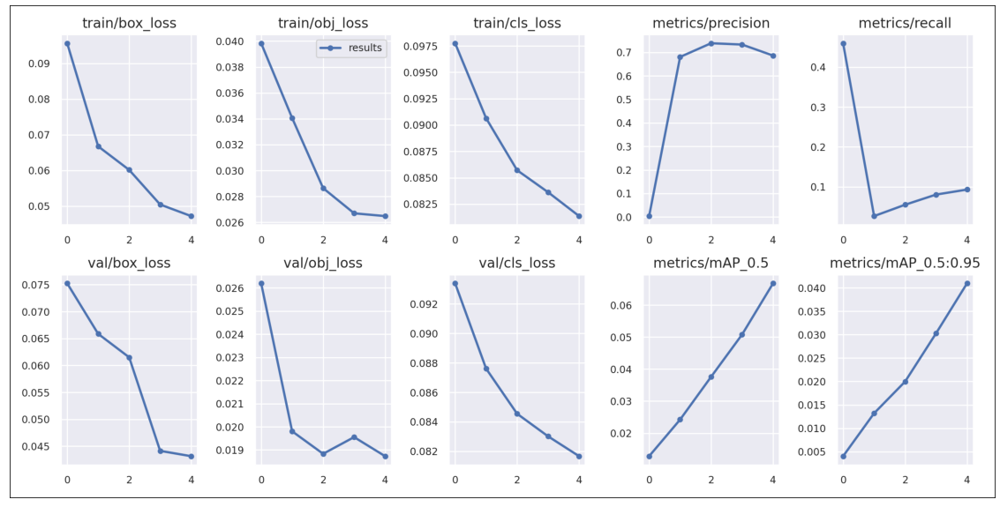

In [49]:
import matplotlib.pyplot as plt
res_path = 'results.png'
img = plt.imread(res_path)
plt.figure(figsize=(20, 20))
plt.imshow(img)
plt.xticks([])
plt.yticks([])
plt.show()

In [50]:
import pandas as pd

pd.read_csv('results.csv')

,epoch,train/box_loss,train/obj_loss,train/cls_loss,metrics/precision,...,val/obj_loss,val/cls_loss,x/lr0,x/lr1,x/lr2
0,0,0.095628,0.039838,0.097752,0.003668,...,0.026199,0.093393,0.070400,0.003289,0.003289
1,1,0.066752,0.034059,0.090638,0.680300,...,0.019804,0.087607,0.039089,0.005311,0.005311
2,2,0.060160,0.028640,0.085711,0.738590,...,0.018832,0.084549,0.006458,0.006013,0.006013
3,3,0.050462,0.026696,0.083625,0.732960,...,0.019553,0.083018,0.004060,0.004060,0.004060
4,4,0.047223,0.026481,0.081363,0.686120,...,0.018729,0.081672,0.004060,0.004060,0.004060


In [51]:
!cat /content/yolov5/runs/train/exp3/results.csv

               epoch,      train/box_loss,      train/obj_loss,      train/cls_loss,   metrics/precision,      metrics/recall,     metrics/mAP_0.5,metrics/mAP_0.5:0.95,        val/box_loss,        val/obj_loss,        val/cls_loss,               x/lr0,               x/lr1,               x/lr2
                   0,            0.095628,            0.039838,            0.097752,           0.0036684,             0.45986,            0.012804,           0.0040389,            0.075251,            0.026199,            0.093393,              0.0704,           0.0032889,           0.0032889
                   1,            0.066752,            0.034059,            0.090638,              0.6803,            0.026376,            0.024236,            0.013206,            0.065865,            0.019804,            0.087607,            0.039089,            0.005311,            0.005311
                   2,             0.06016,             0.02864,            0.085711,             0.73859,            0

<a href="/kaggle/working/yolov5/runs/train/exp/results.csv"> Download File </a>


In [53]:
import os
os.chdir(r'/content/yolov5/runs/train/exp3')
from IPython.display import FileLink
FileLink(r'results.csv')

/content/yolov5/runs/train/exp3/results.csv

In [54]:
%cd /content/yolov5

/content/yolov5


In [62]:
# !cp runs/exp/weights/best.pt weights
!python detect.py --weights runs/train/exp3/weights/best.pt --img 640 --conf 0.05 --source taco/test/images 

detect: weights=['runs/train/exp3/weights/best.pt'], source=taco/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.05, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-43-gf72f0fe Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5l summary: 267 layers, 46425993 parameters, 0 gradients, 108.7 GFLOPs
image 1/150 /content/yolov5/taco/test/images/batch_1-000029.jpg: 640x480 1 Clear plastic bottle, 1 Plastic film, 40.5ms
image 2/150 /content/yolov5/taco/test/images/batch_1-000045.jpg: 480x640 3 Clear plastic bottles, 1 Drink can, 5 Plastic films, 35.0ms
image 3/150 /content/yolov5/taco/test/images/batch_1-000047.jpg: 480x640 3 Clear plastic b

In [67]:
!pwd

/content/yolov5


In [68]:
!ls runs/detect/exp3

batch_10-000002.jpg  batch_15-000028.jpg   batch_6-000061.JPG
batch_10-000008.jpg  batch_15-000029.jpg   batch_6-000064.JPG
batch_10-000009.jpg  batch_15-000035.jpg   batch_6-000066.JPG
batch_10-000013.jpg  batch_15-000041.jpg   batch_6-000073.JPG
batch_10-000019.jpg  batch_15-000042.jpg   batch_6-000096.JPG
batch_10-000032.jpg  batch_15-000046.jpg   batch_6-000097.JPG
batch_10-000035.jpg  batch_15-000080.jpg   batch_6-000101.JPG
batch_10-000036.jpg  batch_15-000082.jpg   batch_6-000103.JPG
batch_10-000039.jpg  batch_2-000029.JPG    batch_7-000011.JPG
batch_10-000046.jpg  batch_2-000030.JPG    batch_7-000024.JPG
batch_10-000059.jpg  batch_2-000033.JPG    batch_7-000031.JPG
batch_1-000029.jpg   batch_2-000039.JPG    batch_7-000053.JPG
batch_1-000045.jpg   batch_2-000040.JPG    batch_7-000068.JPG
batch_1-000047.jpg   batch_2-000041.JPG    batch_7-000073.JPG
batch_1-000065.JPG   batch_2-000055.JPG    batch_7-000077.JPG
batch_1-000108.JPG   batch_2-000067.JPG    batch_7-000080.JPG
batch_1-

In [77]:
import glob
from IPython.display import Image, display

def inspectPerformance(mode, run):
    cnt = 0 
    %cd yolov5
    for imageName in glob.glob('/content/yolov5/runs/{}/{}/*.jpg'.format(mode,run)): #assuming JPG
        display(Image(filename=imageName))
        print("\n")
        cnt += 1
        if cnt == 5:
            break

[Errno 2] No such file or directory: 'yolov5'
/content/yolov5/runs/train/exp3


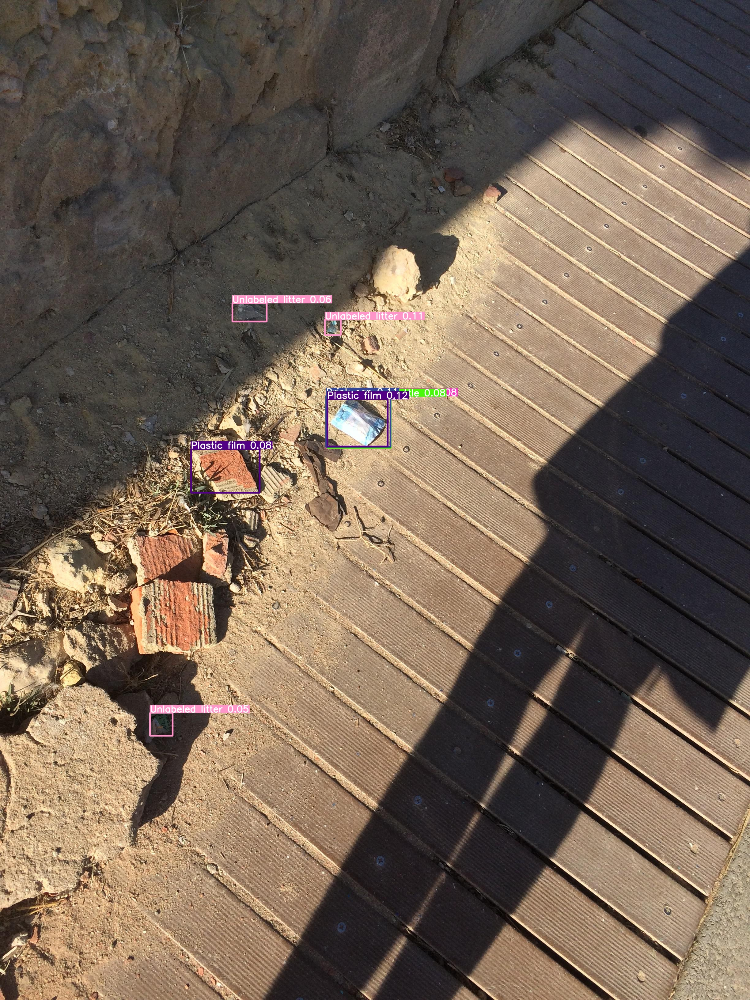

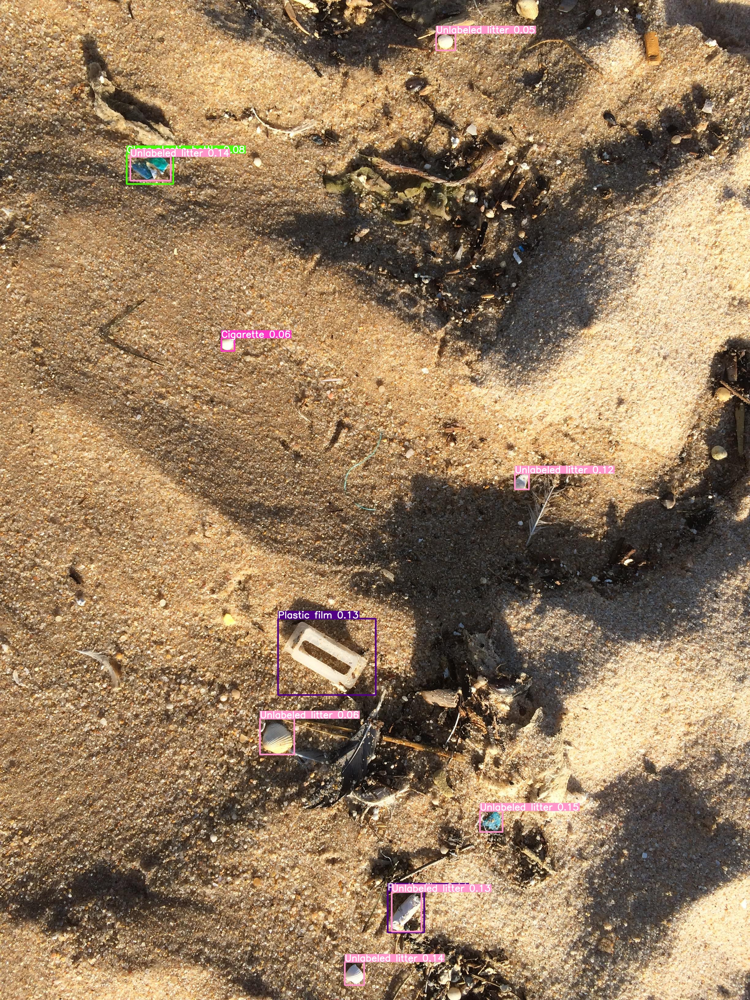

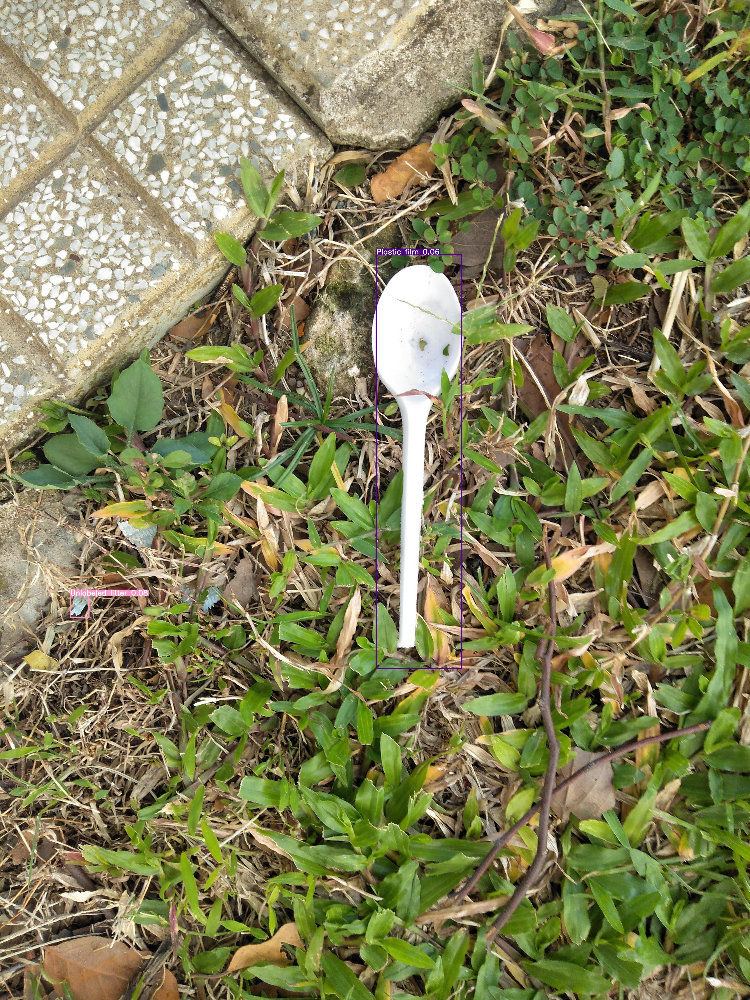

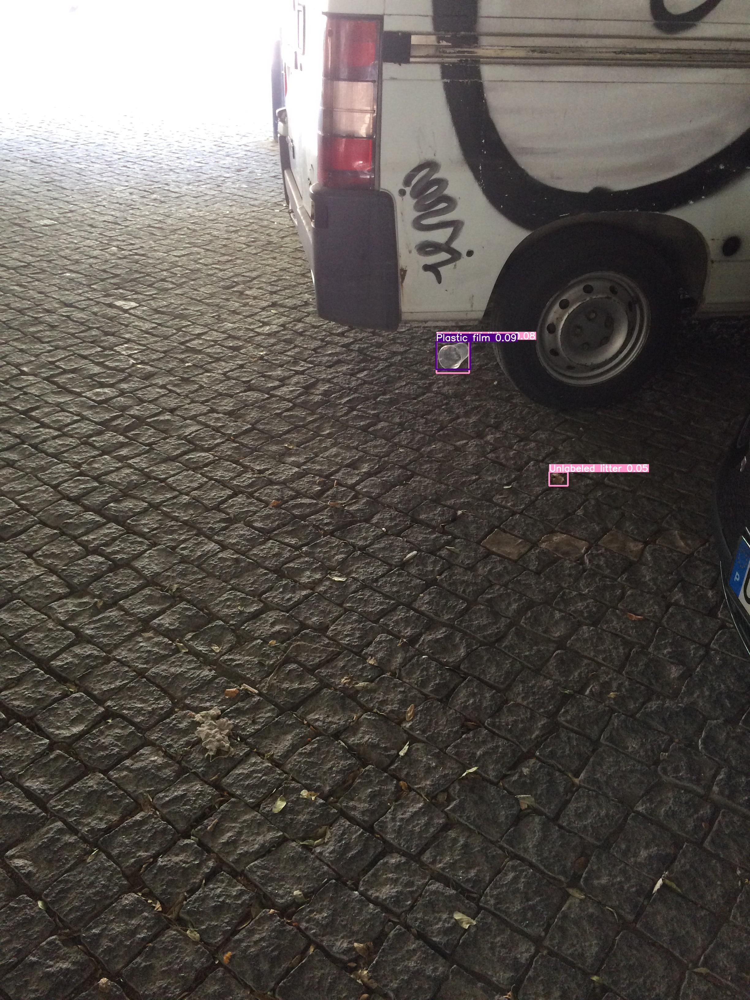

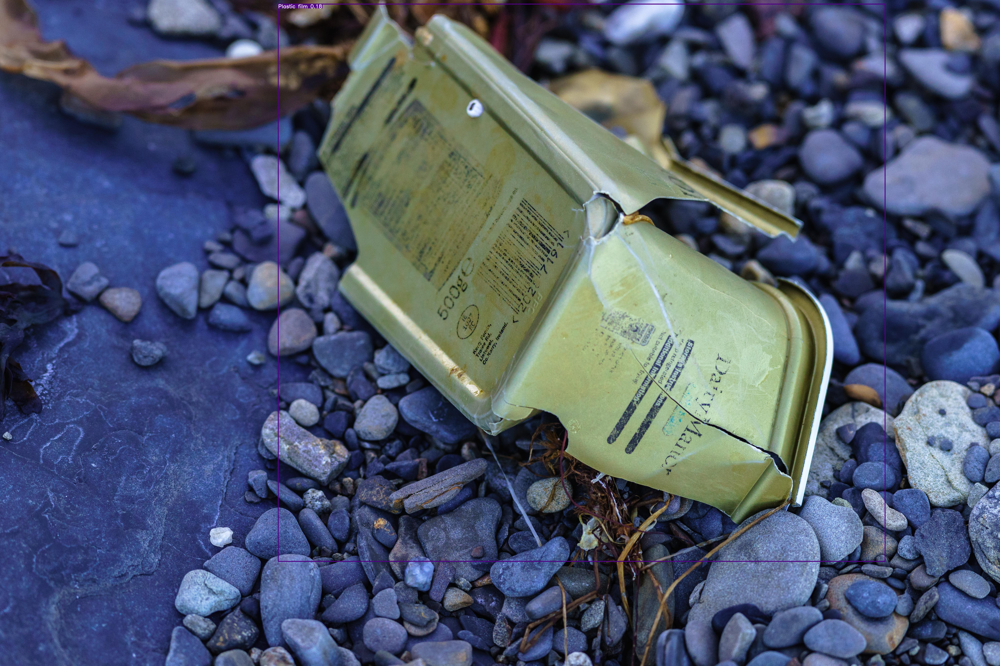

In [78]:
# we use the helper function defined above to view the TEST results from EXP __ (we can see this from the last line in the 
# log output after running the test command)
inspectPerformance("detect", "exp3") # change 'exp19' to the name of your test_run

In [73]:
!python test.py

val: data=data/coco128.yaml, weights=yolov5s.pt, batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-43-gf72f0fe Python-3.8.16 torch-1.13.0+cu116 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients

Dataset not found ⚠️, missing paths ['/content/datasets/coco128/images/train2017']
100% 6.66M/6.66M [00:00<00:00, 29.3MB/s]
Dataset download success ✅ (0.7s), saved to /content/datasets
val: Scanning /content/datasets/coco128/labels/train2017... 126 images, 2 backgrounds, 0 corrupt: 100% 128/128 [00:00<00:00, 1460.57it/s]
val: New cache created: /content/datasets/coco128/labels/train2017.cache
                 Class     Images  Instances          P          R      mAP50   mAP50-95: 100% 4/4 [0

**Show Training Result**

In [75]:
%cd '/content/yolov5/runs/train/exp3'
%ls

/content/yolov5/runs/train/exp3
confusion_matrix.png                                results.png
events.out.tfevents.1671550813.64290439b752.4991.0  train_batch0.jpg
F1_curve.png                                        train_batch1.jpg
hyp.yaml                                            train_batch2.jpg
labels_correlogram.jpg                              val_batch0_labels.jpg
labels.jpg                                          val_batch0_pred.jpg
opt.yaml                                            val_batch1_labels.jpg
P_curve.png                                         val_batch1_pred.jpg
PR_curve.png                                        val_batch2_labels.jpg
R_curve.png                                         val_batch2_pred.jpg
results.csv                                         weights/


[Errno 2] No such file or directory: 'yolov5'
/content/yolov5/runs/train/exp3


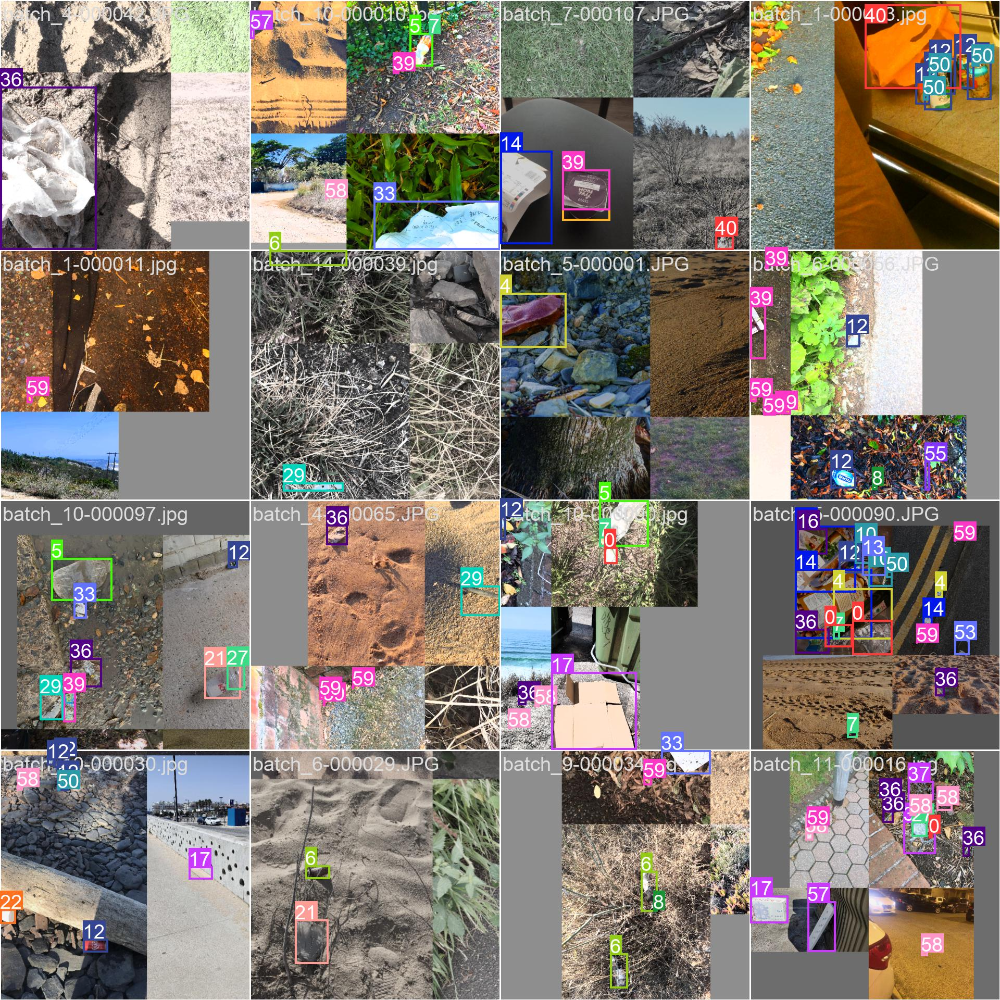

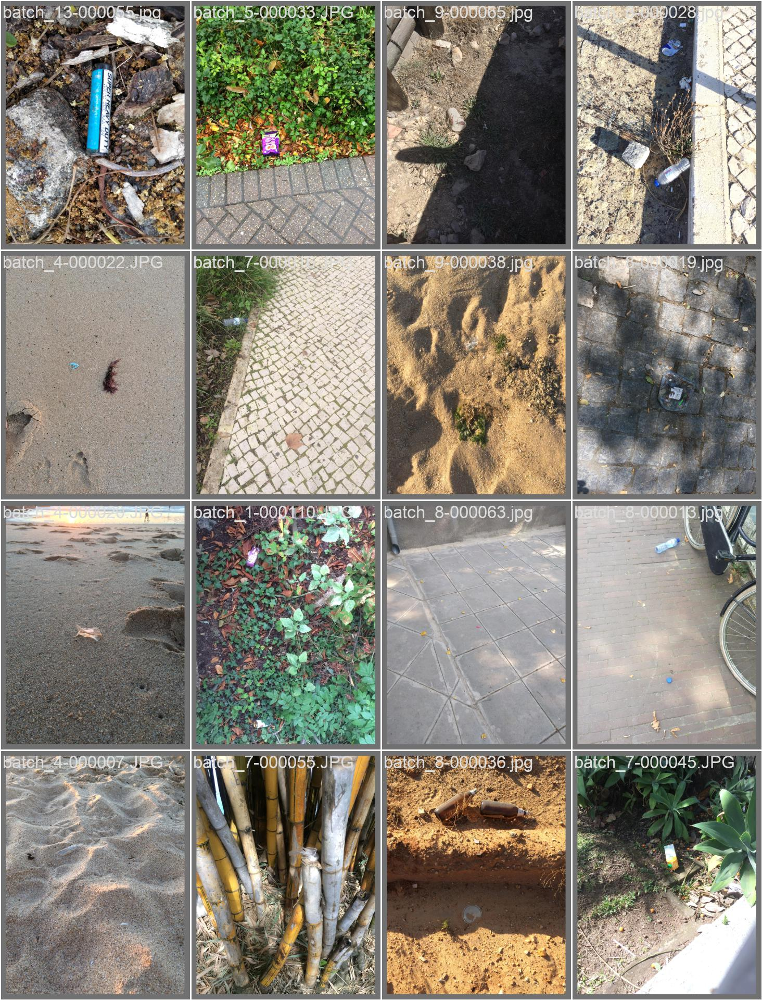

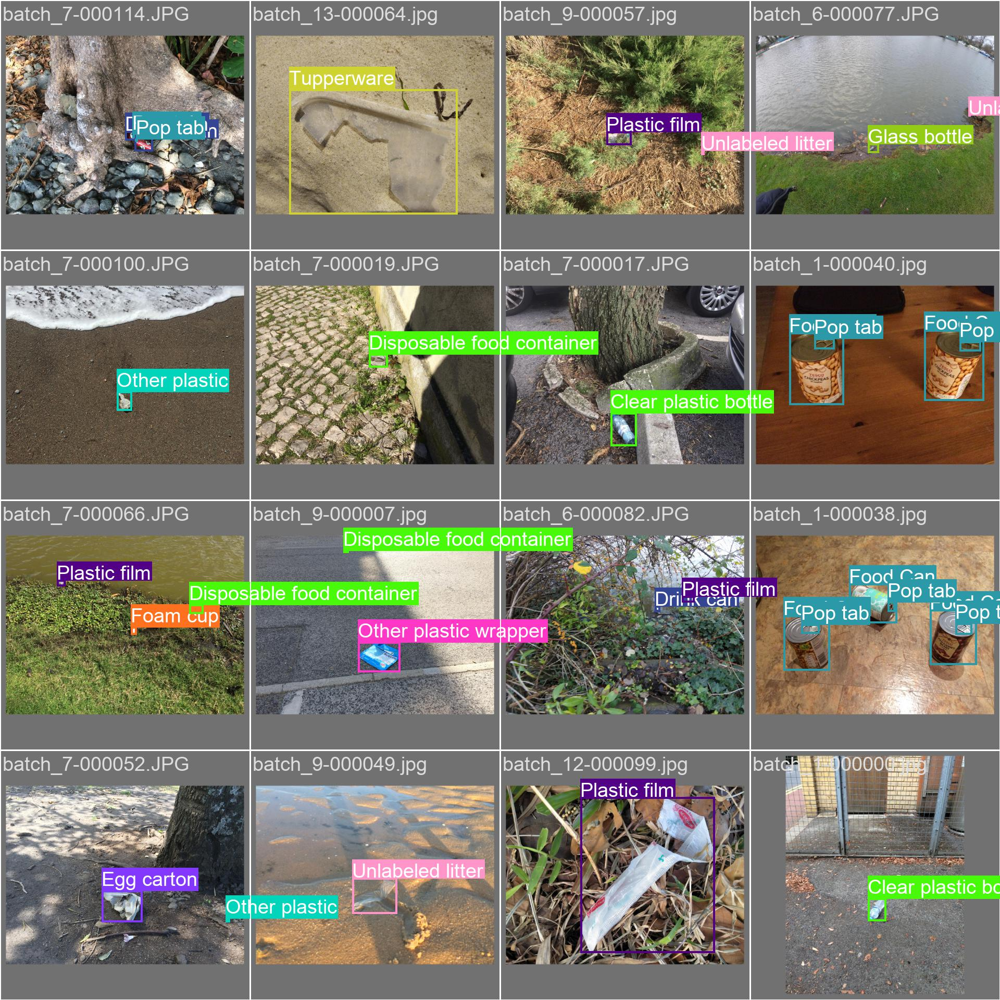

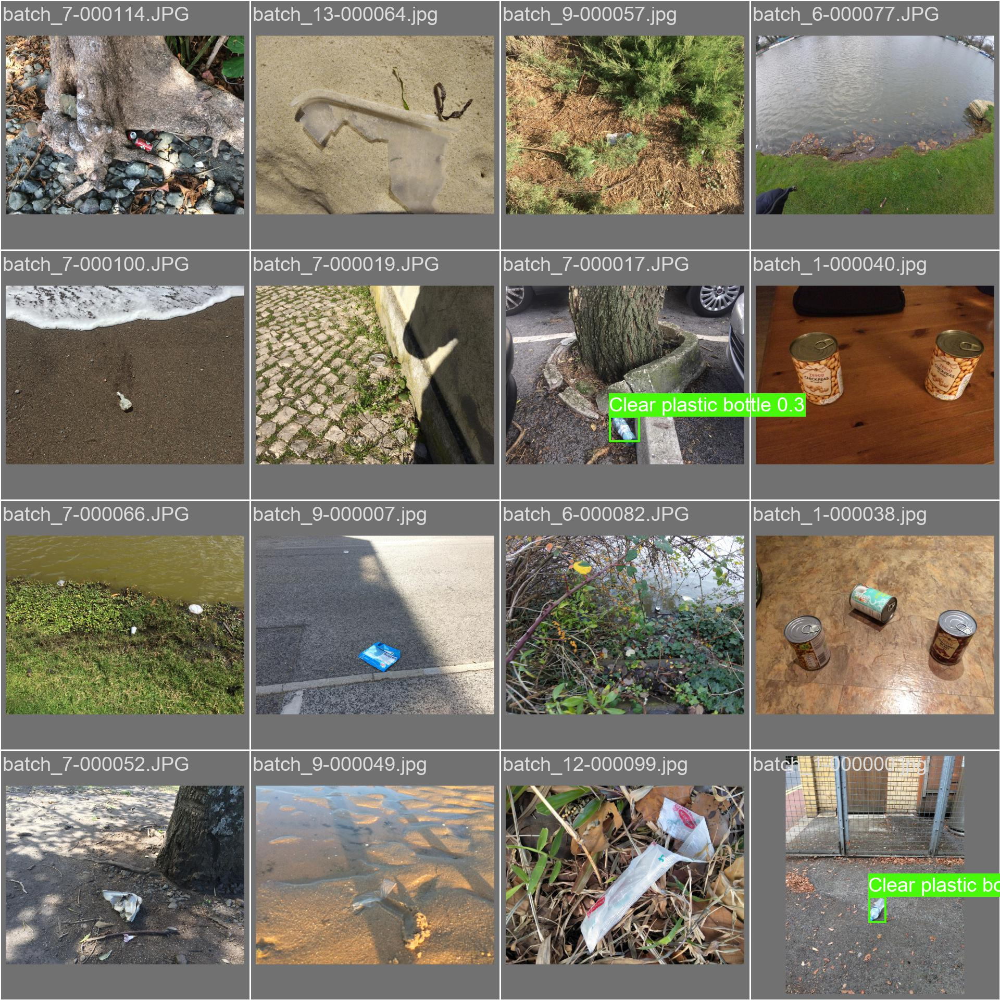

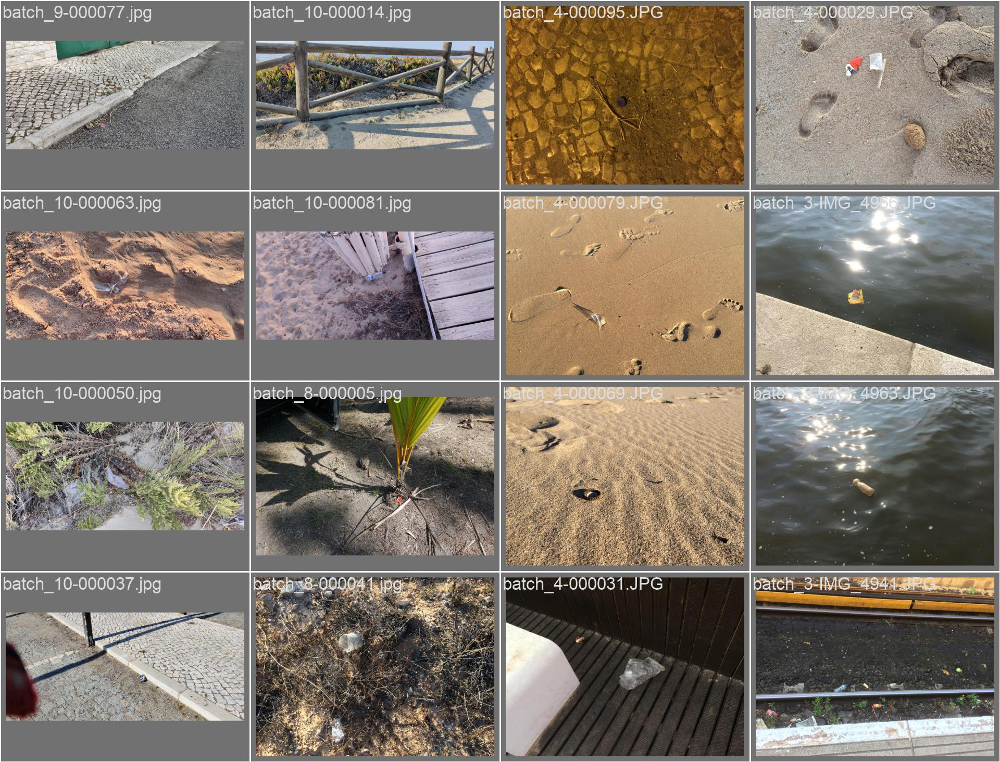

In [79]:
inspectPerformance("train", "exp3")